# Set Up

In [1]:
import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import re
# import scarches as sca

In [2]:
import session_info
session_info.show()

In [49]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=200, facecolor='white', color_map = 'RdPu',dpi_save=300)

# Paths & variables

In [4]:
#set relevant label key
compartment='AllCompartments'
cell_type_key = 'MidGrainModified'
batch_key='batch_key'
job_name=f'AtlasT21ToF_WithContCovariates_{cell_type_key}_{compartment}'
job_name

'AtlasT21ToF_WithContCovariates_MidGrainModified_AllCompartments'

In [5]:
#paths
base_path='/lustre/scratch126/cellgen/team205/jc48/jupyter/scArches'
data_dir=os.path.join(base_path,'data')
results_dir=os.path.join(base_path,f'results/{job_name}')
adata_path=os.path.join(results_dir,'anndata/')
models_path=os.path.join(results_dir,'models/')

# Read in data

## Atlas

In [6]:
# reference data
adata_ref = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Feb28ObjectRaw.h5ad')

# subset as appropriate
print(adata_ref.shape)
if compartment != "AllCompartments":
    adata_ref = adata_ref[adata_ref.obs.coarse_grain==compartment]
print(adata_ref.shape)

# Modify the mid_grain label since the CCS cells bridge two major clusters
rename_dict = {
    "SinoatrialNodeCardiomyocytes": "AtrialCardiomyocytes",
    "AtrioventricularNodeCardiomyocytes": "AtrialCardiomyocytes",
    "VentricularConductionSystemDistal": "VentricularCardiomyocytes",
    "VentricularConductionSystemProximal": "VentricularCardiomyocytes"
}

# Create the "MidGrainModified" column using the mapping logic
adata_ref.obs["MidGrainModified"] = adata_ref.obs["fine_grain"].map(rename_dict).fillna(adata_ref.obs["mid_grain"])

print(adata_ref.X.data[:10])
adata_ref

(297473, 36601)
(297473, 36601)
[ 1.  1.  5.  5.  8.  4. 13.  4.  3.  1.]


AnnData object with n_obs × n_vars = 297473 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified'
    var: 'gene_name_scRNA-0', 'gene_id'
    uns: 'FACSgate_colors', '_scvi_manager_uuid', '_scvi_uuid', 'age_co

## T21ToF Combined data

In [7]:
file_path=os.path.join(adata_path,f'{job_name}_adata_que_T21ToF.h5ad')
adata_que=sc.read(file_path)

# subset as appropriate
print(adata_que.shape)
if compartment != "AllCompartments":
    adata_que = adata_que[adata_que.obs.coarse_grain==compartment]
print(adata_que.shape)

print(adata_que.X.data[:10])
adata_que

(92194, 18642)
(92194, 18642)
[ 1. 24.  7.  4.  1. 14.  3.  1.  3.  2.]


AnnData object with n_obs × n_vars = 92194 × 18642
    obs: 'age', 'batch_key', 'cell_or_nuclei', 'diagnosis', 'donor', 'kit_10x', 'n_counts', 'n_genes', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'region', 'sex', 'total_counts', 'total_counts_mt', 'total_counts_ribo'

# Concatenate to make full object

In [8]:
# concatenate
adata = adata_ref.concatenate(adata_que, 
                              index_unique = None, 
                              batch_key= 'original_or_new',
                                  batch_categories=['original','new'])

print(adata.X.data[:10])
adata

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


[  2.  60.   4.  17.  53.  89.  54.  67.  42. 246.]


AnnData object with n_obs × n_vars = 389667 × 18642
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified', 'diagnosis', 'original_or_new'
    var: 'gene_name_scRNA-0-original', 'gene_id-original'

In [9]:
adata.obs.head(3)

,latent_RT_efficiency,latent_cell_probability,latent_scale,sangerID,combinedID,donor,region,age,facility,cell_or_nuclei,...,cycling,S_score,G2M_score,phase,_scvi_labels,stress_score,hb1_score,MidGrainModified,diagnosis,original_or_new
BHF_F_Hea10402917_TGGCTGGGTTGTGGAG-1,5.218614,0.999939,123665.210938,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,yes,0.002509,-0.056211,S,0.0,0.611262,-0.238230,BloodVesselEndothelialCells,NaN,original
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1,3.109560,0.999991,10201.502930,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,yes,0.726850,0.094688,S,0.0,1.123909,-0.121226,LymphoidCells,NaN,original
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1,3.181446,0.999989,10217.305664,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,yes,0.413170,1.200272,G2M,0.0,0.502809,-0.134926,LymphoidCells,NaN,original


In [10]:
adata.var.head(3)

,gene_name_scRNA-0-original,gene_id-original
AL627309.1,AL627309.1,ENSG00000238009
AP006222.2,AP006222.2,ENSG00000286448
FAM87B,FAM87B,ENSG00000177757


In [11]:
adata.X.data[:10]

array([  2.,  60.,   4.,  17.,  53.,  89.,  54.,  67.,  42., 246.],
      dtype=float32)

# Add metadata

In [12]:
adata.obs['age_original']=adata.obs['age']
adata.obs['age_original'].value_counts()

age_original
20W0D       104878
14W0D        63970
13W0D        60330
15W0D        25386
8W6D         17547
5W4D         13770
7W5D         12985
6W4D          9702
7W1D          9121
7W6D          7948
12W0D         7268
0y_7m_3d      7213
6W1D          6854
9W3D          6412
10W5D         6376
0y_8m_9d      6195
7W3D          5662
6W5D          4129
8W4D          3907
7W0D          2660
4W3D          2490
9W2D          2436
0y_3m_3d      2428
Name: count, dtype: int64

In [13]:
# Convert post natal ages to post conception
def convert_age(age):
    # Check if age is already in XWYD format
    if re.match(r'\d+W\d+D', age):
        return age
    
    # Check if age is in the format Xy_Ym_Zd
    elif re.match(r'\d+y_\d+m_\d+d', age):
        years, months, days = map(int, re.findall(r'\d+', age))
        
        # Convert years, months, days to weeks and days post conception
        weeks_post_conception = 40 * years + 4.34524 * months + days / 7 + 40 # add 40 weeks of gestation
        weeks = int(weeks_post_conception)
        days = round((weeks_post_conception - weeks) * 7)
        
        # Return age in the format XWYD
        return f'{weeks}W{days}D'
    
    else:
        return age

# Apply the helper function to the 'age' column
adata.obs['age'] = adata.obs['age'].apply(convert_age)

# Verify the changes
print(adata.obs['age'].value_counts())


age
20W0D    104878
14W0D     63970
13W0D     60330
15W0D     25386
8W6D      17547
5W4D      13770
7W5D      12985
6W4D       9702
7W1D       9121
7W6D       7948
12W0D      7268
70W6D      7213
6W1D       6854
9W3D       6412
10W5D      6376
76W0D      6195
7W3D       5662
6W5D       4129
8W4D       3907
7W0D       2660
4W3D       2490
9W2D       2436
53W3D      2428
Name: count, dtype: int64


In [14]:
# convert age to be a continous variable
import re

def age_to_days(age_str):
    match = re.match(r'(\d+)W(\d+)D', age_str)
    if match:
        weeks, days = map(int, match.groups())
        return float(weeks * 7 + days)
    else:
        return None

# Assuming 'adata' is an AnnData object
adata.obs['age_days'] = adata.obs['age'].apply(age_to_days)
adata.obs['age_days']=adata.obs['age_days'].astype(float)

<Axes: >

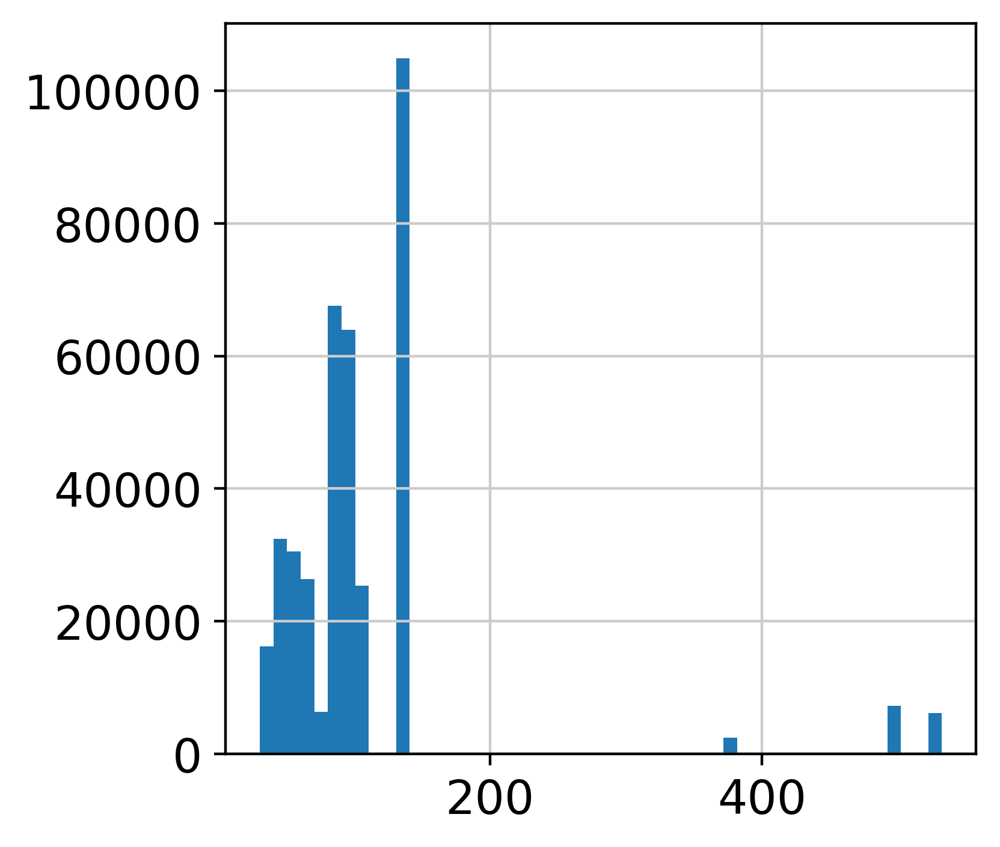

In [32]:
adata.obs.age_days.hist(bins=50)

In [15]:
import genomic_features as gf
ensdb = gf.ensembl.annotation(species="Hsapiens", version="109")
genes = ensdb.genes()
genes.head(3)

,gene_id,gene_name,gene_biotype,gene_seq_start,gene_seq_end,seq_name,seq_strand,seq_coord_system,description,gene_id_version,canonical_transcript
0,ENSG00000000003,TSPAN6,protein_coding,100627108,100639991,X,-1,chromosome,tetraspanin 6 [Source:HGNC Symbol;Acc:HGNC:11858],ENSG00000000003.15,ENST00000373020
1,ENSG00000000005,TNMD,protein_coding,100584936,100599885,X,1,chromosome,tenomodulin [Source:HGNC Symbol;Acc:HGNC:17757],ENSG00000000005.6,ENST00000373031
2,ENSG00000000419,DPM1,protein_coding,50934867,50959140,20,-1,chromosome,dolichyl-phosphate mannosyltransferase subunit...,ENSG00000000419.14,ENST00000371588


In [16]:
genes['gene_id-original']=genes['gene_id']

adata.var = (
    adata.var.reset_index(names='GENE_NAME')
    .merge(genes, on="gene_id-original", how='left')
    .set_index("GENE_NAME")
)

adata.var['sex_chromosome']=adata.var.seq_name.isin(['X','Y'])

adata.var.head(3)

,gene_name_scRNA-0-original,gene_id-original,gene_id,gene_name,gene_biotype,gene_seq_start,gene_seq_end,seq_name,seq_strand,seq_coord_system,description,gene_id_version,canonical_transcript,sex_chromosome
GENE_NAME,,,,,,,,,,,,,,
AL627309.1,AL627309.1,ENSG00000238009,ENSG00000238009,,lncRNA,89295.0,133723.0,1,-1.0,chromosome,novel transcript,ENSG00000238009.6,ENST00000477740,False
AP006222.2,AP006222.2,ENSG00000286448,ENSG00000286448,,lncRNA,266855.0,268655.0,1,1.0,chromosome,novel transcript,ENSG00000286448.1,ENST00000669836,False
FAM87B,FAM87B,ENSG00000177757,ENSG00000177757,FAM87B,lncRNA,817371.0,819837.0,1,1.0,chromosome,family with sequence similarity 87 member B [S...,ENSG00000177757.2,ENST00000326734,False


# Add in scArches data

## Latent space

In [17]:
file_path=os.path.join(adata_path,f'{job_name}_full_latent.h5ad')
full_latent=sc.read(file_path)
full_latent

AnnData object with n_obs × n_vars = 389667 × 50
    obs: 'cell_type', 'batch', 'predictions', 'original_or_new', 'diagnosis'
    uns: 'batch_colors', 'cell_type_colors', 'diagnosis_colors', 'neighbors', 'original_or_new_colors', 'predictions_colors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [18]:
latent_X=pd.DataFrame(full_latent.X)
latent_X.index=full_latent.obs_names
latent_X.head(3)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
BHF_F_Hea10402917_TGGCTGGGTTGTGGAG-1,-2.992568,-11.567996,-9.565477,2.787743,-10.608111,-1.416014,1.293941,-0.246633,1.452591,11.304872,...,-1.857882,8.057562,13.986519,-2.943369,-1.539647,2.912666,17.359867,-4.601806,-0.064453,4.503499
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1,-2.803258,-5.217883,1.367828,-4.623782,0.058613,0.267918,12.136313,10.389952,9.295958,2.561138,...,-9.045876,4.236239,9.228603,-1.354207,-1.855668,-1.011317,11.467386,-2.003126,5.035590,3.394660
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1,-3.939302,-1.277142,-1.379554,-2.257360,-2.785168,1.277155,-0.591742,4.035853,2.829442,13.503642,...,-8.100840,10.567349,5.469000,0.043525,1.020817,0.921210,7.961302,2.409115,10.887959,-5.961543


In [19]:
adata.obsm['X_scArches']=latent_X

## scANVI predictions

In [20]:
# Get a list of columns that are only present in the second DataFrame
cols_to_add = full_latent.obs.columns.difference(adata.obs.columns)

# Merge only those columns from second DataFrame which are not present in the first DataFrame
adata.obs = adata.obs.merge(full_latent.obs[cols_to_add], left_index=True, right_index=True, how='inner')
adata.obs.rename(columns={'predictions':'scANVI_predictions'},inplace=True)
adata.obs

,latent_RT_efficiency,latent_cell_probability,latent_scale,sangerID,combinedID,donor,region,age,facility,cell_or_nuclei,...,stress_score,hb1_score,MidGrainModified,diagnosis,original_or_new,age_original,age_days,batch,cell_type,scANVI_predictions
BHF_F_Hea10402917_TGGCTGGGTTGTGGAG-1,5.218614,0.999939,123665.210938,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,0.611262,-0.238230,BloodVesselEndothelialCells,NaN,original,10W5D,75.0,C86_Cell_5prime-v2,BloodVesselEndothelialCells,BloodVesselEndothelialCells
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1,3.109560,0.999991,10201.502930,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,1.123909,-0.121226,LymphoidCells,NaN,original,10W5D,75.0,C86_Cell_5prime-v2,LymphoidCells,LymphoidCells
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1,3.181446,0.999989,10217.305664,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,0.502809,-0.134926,LymphoidCells,NaN,original,10W5D,75.0,C86_Cell_5prime-v2,LymphoidCells,LymphoidCells
BHF_F_Hea10402917_TACAGTGTCCAGTATG-1,3.101654,0.999993,9392.824219,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,1.057994,-0.103145,MyeloidCells,NaN,original,10W5D,75.0,C86_Cell_5prime-v2,MyeloidCells,MyeloidCells
BHF_F_Hea10402917_ACCAGTATCCACTCCA-1,3.109215,0.999989,9608.674805,BHF_F_Hea10402917,na,C86,whole sample,10W5D,Sanger,cell,...,0.848548,-0.142657,MyeloidCells,NaN,original,10W5D,75.0,C86_Cell_5prime-v2,MyeloidCells,MyeloidCells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P28_1_CCACTTGAGCGTCTCG-1,NaN,NaN,NaN,NaN,NaN,P28,RVOT,76W0D,NaN,nuclei,...,NaN,NaN,NaN,TOF,new,0y_8m_9d,532.0,P28_nuclei_3prime-v3,Unknown,Fibroblasts
P28_2_TGCGACGTCCTAGCGG-1,NaN,NaN,NaN,NaN,NaN,P28,RVOT,76W0D,NaN,nuclei,...,NaN,NaN,NaN,TOF,new,0y_8m_9d,532.0,P28_nuclei_3prime-v3,Unknown,Fibroblasts
P28_2_CGGAGAAAGCTGGCCT-1,NaN,NaN,NaN,NaN,NaN,P28,RVOT,76W0D,NaN,nuclei,...,NaN,NaN,NaN,TOF,new,0y_8m_9d,532.0,P28_nuclei_3prime-v3,Unknown,Fibroblasts
P33_10k_AAACGCTAGTATAGGT-1,NaN,NaN,NaN,NaN,NaN,P33,RVOT,70W6D,NaN,nuclei,...,NaN,NaN,NaN,TOF,new,0y_7m_3d,496.0,P33_nuclei_3prime-v3,Unknown,Fibroblasts


In [21]:
set(adata.obs[cell_type_key])

{'AtrialCardiomyocytes',
 'BloodVesselEndothelialCells',
 'EndocardialCells',
 'EpicardialCells',
 'Fibroblasts',
 'Glia',
 'LymphaticEndothelialCells',
 'LymphoidCells',
 'MuralCells',
 'MyeloidCells',
 'Neurons',
 'PericardialCells',
 'VentricularCardiomyocytes',
 nan}

In [22]:
adata.obs[cell_type_key] = adata.obs[cell_type_key].astype('str')
adata.obs.loc[adata_que.obs_names,cell_type_key] = adata.obs.loc[adata_que.obs_names,'scANVI_predictions'].astype('str')
set(adata.obs[cell_type_key])

{'AtrialCardiomyocytes',
 'BloodVesselEndothelialCells',
 'EndocardialCells',
 'EpicardialCells',
 'Fibroblasts',
 'Glia',
 'LymphaticEndothelialCells',
 'LymphoidCells',
 'MuralCells',
 'MyeloidCells',
 'Neurons',
 'PericardialCells',
 'VentricularCardiomyocytes'}

In [23]:
adata

AnnData object with n_obs × n_vars = 389667 × 18642
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified', 'diagnosis', 'original_or_new', 'age_original', 'age_days', 'batch', 'cell_type', 'scANVI_predictions'
    var

# Add in CellTypist labels

In [24]:
#T21 labels

label_types=["coarse","mid","fine"]

list_of_label_dfs=[]


for label_type in label_types:
    # read in labels
    labels=pd.read_csv(f'/nfs/team205/heart/anndata_objects/Foetal/trisomy21/CellTypist_labelling/T21_predictions_{label_type}_df.csv', index_col=0)
    labels=labels.add_prefix(label_type+'_')
    list_of_label_dfs.append(labels)

T21_labels=pd.concat(list_of_label_dfs, axis=1)
print(T21_labels.shape)
T21_labels.head(3)

(76358, 9)


,coarse_predicted_labels,coarse_prob,coarse_prob_minus_background,mid_predicted_labels,mid_prob,mid_prob_minus_background,fine_predicted_labels,fine_prob,fine_prob_minus_background
X,,,,,,,,,
BHF_F_Hea13188319_BHF_F_Hea13187621_TAAGGACCATGTCAAT-1,Mesenchymal,0.929917,0.929635,MuralCells,0.402490,0.402208,CoronarySmoothMuscleCells,0.255889,0.255607
BHF_F_Hea13188319_BHF_F_Hea13187621_CGTTTCTCATGAATCT-1,Endothelium,0.970691,0.970534,BloodVesselEndothelialCells,0.993314,0.993157,CoronarySmoothMuscleCells,0.023086,0.022930
BHF_F_Hea13188319_BHF_F_Hea13187621_GATCACTAGCACGTTG-1,Mesenchymal,0.999997,0.999879,PericardialCells,0.817508,0.817390,GreatVesselAdventitialFibroblasts,0.007167,0.007049


In [25]:
# ToF labels

dataset='ToF'

file_path=f'/lustre/scratch126/cellgen/team205/jc48/jupyter/scArches/results/AtlasT21ToF_WithContCovariates_MidGrainModified_AllCompartments/{dataset}_predictions_df.csv'
ToF_labels=pd.read_csv(file_path, index_col=0)
ToF_labels

,fine_CellTypist_predicted_labels,fine_CellTypist_over_clustering,fine_CellTypist_majority_voting,fine_CellTypist_conf_score,mid_CellTypist_predicted_labels,mid_CellTypist_over_clustering,mid_CellTypist_majority_voting,mid_CellTypist_conf_score,coarse_CellTypist_predicted_labels,coarse_CellTypist_over_clustering,coarse_CellTypist_majority_voting,coarse_CellTypist_conf_score
P26_1_AGTGCCGAGATAACGT-1,VentricularCardiomyocytesRightCompact,12,VentricularCardiomyocytesRightCompact,0.008608,VentricularCardiomyocytes,12,VentricularCardiomyocytes,0.951256,Cardiomyocytes,12,Cardiomyocytes,0.999995
P26_1_TCGCACTCATATCGGT-1,VentricularCardiomyocytesRightTrabeculated,1,VentricularCardiomyocytesRightCompact,0.003694,VentricularCardiomyocytes,1,VentricularCardiomyocytes,0.952763,Cardiomyocytes,1,Cardiomyocytes,1.000000
P33_10k_CATTGCCAGCGTCAAG-1,VentricularCardiomyocytesRightCompact,11,VentricularCardiomyocytesRightCompact,0.001944,VentricularCardiomyocytes,11,VentricularCardiomyocytes,0.246197,Cardiomyocytes,11,Cardiomyocytes,0.999964
P33_10k_GAGAAATGTTCTCCCA-1,VentricularCardiomyocytesRightCompact,11,VentricularCardiomyocytesRightCompact,0.004305,CardiacConductionSystem,11,VentricularCardiomyocytes,0.053509,Cardiomyocytes,11,Cardiomyocytes,0.999967
P33_10k_CAGCAGCCACCCTGAG-1,VentricularCardiomyocytesRightCompact,11,VentricularCardiomyocytesRightCompact,0.001500,VentricularCardiomyocytes,11,VentricularCardiomyocytes,0.052847,Cardiomyocytes,11,Cardiomyocytes,0.999892
...,...,...,...,...,...,...,...,...,...,...,...,...
P28_1_CCACTTGAGCGTCTCG-1,MyocardialInterstitialFibroblasts1,3,MyocardialInterstitialFibroblasts1,0.001371,Fibroblasts,3,Fibroblasts,0.682194,Mesenchymal,3,Mesenchymal,0.824592
P28_2_TGCGACGTCCTAGCGG-1,MyocardialInterstitialFibroblasts1,22,MyocardialInterstitialFibroblasts1,0.000941,Fibroblasts,22,Fibroblasts,0.683048,Mesenchymal,22,Mesenchymal,0.932603
P28_2_CGGAGAAAGCTGGCCT-1,MyocardialInterstitialFibroblasts1,22,MyocardialInterstitialFibroblasts1,0.000496,Fibroblasts,22,Fibroblasts,0.087808,Mesenchymal,22,Mesenchymal,0.744801
P33_10k_AAACGCTAGTATAGGT-1,MyocardialInterstitialFibroblasts1,5,MyocardialInterstitialFibroblasts1,0.007601,Fibroblasts,5,Fibroblasts,0.076164,Mesenchymal,5,Mesenchymal,0.799071


In [26]:
T21_labels.columns

Index(['coarse_predicted_labels', 'coarse_prob',
       'coarse_prob_minus_background', 'mid_predicted_labels', 'mid_prob',
       'mid_prob_minus_background', 'fine_predicted_labels', 'fine_prob',
       'fine_prob_minus_background'],
      dtype='object')

In [27]:
ToF_labels.columns

Index(['fine_CellTypist_predicted_labels', 'fine_CellTypist_over_clustering',
       'fine_CellTypist_majority_voting', 'fine_CellTypist_conf_score',
       'mid_CellTypist_predicted_labels', 'mid_CellTypist_over_clustering',
       'mid_CellTypist_majority_voting', 'mid_CellTypist_conf_score',
       'coarse_CellTypist_predicted_labels',
       'coarse_CellTypist_over_clustering',
       'coarse_CellTypist_majority_voting', 'coarse_CellTypist_conf_score'],
      dtype='object')

In [28]:
# Renaming ToF_labels to match T21_labels
ToF_labels = ToF_labels.rename(columns={
    'fine_CellTypist_predicted_labels': 'fine_predicted_labels',
    'mid_CellTypist_predicted_labels': 'mid_predicted_labels',
    'coarse_CellTypist_predicted_labels': 'coarse_predicted_labels',
    'fine_CellTypist_conf_score': 'fine_prob',
    'mid_CellTypist_conf_score': 'mid_prob',
    'coarse_CellTypist_conf_score': 'coarse_prob'
})

# Dropping unnecessary columns from ToF_labels
ToF_labels = ToF_labels.drop(columns=[
    'fine_CellTypist_majority_voting',
    'mid_CellTypist_majority_voting',
    'coarse_CellTypist_majority_voting',
    'fine_CellTypist_over_clustering',
    'mid_CellTypist_over_clustering',
    'coarse_CellTypist_over_clustering'
])

# Concatenate T21_labels and ToF_labels
all_labels = pd.concat([T21_labels, ToF_labels])
all_labels

,coarse_predicted_labels,coarse_prob,coarse_prob_minus_background,mid_predicted_labels,mid_prob,mid_prob_minus_background,fine_predicted_labels,fine_prob,fine_prob_minus_background
BHF_F_Hea13188319_BHF_F_Hea13187621_TAAGGACCATGTCAAT-1,Mesenchymal,0.929917,0.929635,MuralCells,0.402490,0.402208,CoronarySmoothMuscleCells,0.255889,0.255607
BHF_F_Hea13188319_BHF_F_Hea13187621_CGTTTCTCATGAATCT-1,Endothelium,0.970691,0.970534,BloodVesselEndothelialCells,0.993314,0.993157,CoronarySmoothMuscleCells,0.023086,0.022930
BHF_F_Hea13188319_BHF_F_Hea13187621_GATCACTAGCACGTTG-1,Mesenchymal,0.999997,0.999879,PericardialCells,0.817508,0.817390,GreatVesselAdventitialFibroblasts,0.007167,0.007049
BHF_F_Hea13188319_BHF_F_Hea13187621_AGCGCTCAGGATGATG-1,Endothelium,0.989049,0.988986,LymphaticEndothelialCells,0.952143,0.952080,LymphaticEndothelialCells,0.952143,0.952080
BHF_F_Hea13188319_BHF_F_Hea13187621_AGGTCCGGTTAACAGT-1,Endothelium,0.905470,0.905340,LymphaticEndothelialCells,0.351521,0.351391,LymphaticEndothelialCells,0.351521,0.351391
...,...,...,...,...,...,...,...,...,...
P28_1_CCACTTGAGCGTCTCG-1,Mesenchymal,0.824592,NaN,Fibroblasts,0.682194,NaN,MyocardialInterstitialFibroblasts1,0.001371,NaN
P28_2_TGCGACGTCCTAGCGG-1,Mesenchymal,0.932603,NaN,Fibroblasts,0.683048,NaN,MyocardialInterstitialFibroblasts1,0.000941,NaN
P28_2_CGGAGAAAGCTGGCCT-1,Mesenchymal,0.744801,NaN,Fibroblasts,0.087808,NaN,MyocardialInterstitialFibroblasts1,0.000496,NaN
P33_10k_AAACGCTAGTATAGGT-1,Mesenchymal,0.799071,NaN,Fibroblasts,0.076164,NaN,MyocardialInterstitialFibroblasts1,0.007601,NaN


In [29]:
'''
all_labels=pd.concat([T21_labels,ToF_labels])
all_labels

label_types=["coarse","mid","fine"]

list_of_label_dfs=[]


for label_type in label_types:
    # read in labels
    labels=pd.read_csv(f'/nfs/team205/heart/anndata_objects/Foetal/trisomy21/CellTypist_labelling/T21_predictions_{label_type}_df.csv', index_col=0)
    labels=labels.add_prefix(label_type+'_')
    list_of_label_dfs.append(labels)

all_labels=pd.concat(list_of_label_dfs, axis=1)
all_labels
'''

'\nall_labels=pd.concat([T21_labels,ToF_labels])\nall_labels\n\nlabel_types=["coarse","mid","fine"]\n\nlist_of_label_dfs=[]\n\n\nfor label_type in label_types:\n    # read in labels\n    labels=pd.read_csv(f\'/nfs/team205/heart/anndata_objects/Foetal/trisomy21/CellTypist_labelling/T21_predictions_{label_type}_df.csv\', index_col=0)\n    labels=labels.add_prefix(label_type+\'_\')\n    list_of_label_dfs.append(labels)\n\nall_labels=pd.concat(list_of_label_dfs, axis=1)\nall_labels\n'

In [30]:
# Save the categorical columns names
categorical_cols = adata.obs.select_dtypes(['category']).columns

# Convert all categorical columns to object type
for col in categorical_cols:
    adata.obs[col] = adata.obs[col].astype('object')

# Save original columns
original_cols = adata.obs.columns

# Join operation
adata.obs = adata.obs.join(all_labels, how='left')

# Identify newly added columns
new_cols = [col for col in adata.obs.columns if col not in original_cols]

# Fill NA only in new columns
#for col in new_cols:
#    adata.obs[col].fillna('atlas', inplace=True)

# Convert to columns to categorical
predicted_label_cols = ['fine_predicted_labels','mid_predicted_labels','coarse_predicted_labels']
all_categorical_cols = categorical_cols.tolist() + predicted_label_cols

for col in all_categorical_cols:
    adata.obs[col] = adata.obs[col].astype('category')

adata.obs.iloc[:,-14:].dtypes

age_original                    category
age_days                         float64
batch                           category
cell_type                       category
scANVI_predictions              category
coarse_predicted_labels         category
coarse_prob                      float64
coarse_prob_minus_background     float64
mid_predicted_labels            category
mid_prob                         float64
mid_prob_minus_background        float64
fine_predicted_labels           category
fine_prob                        float64
fine_prob_minus_background       float64
dtype: object

# Plotting

## Compute UMAP

In [33]:
%%time
sc.pp.neighbors(adata, use_rep="X_scArches")

computing neighbors


/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/lustre/

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:04)
CPU times: user 1min 35s, sys: 3.92 s, total: 1min 39s
Wall time: 1min 4s


In [34]:
%time
sc.tl.umap(adata, min_dist=0.01)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 3.34 µs
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:20)


## UMAP Plots

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


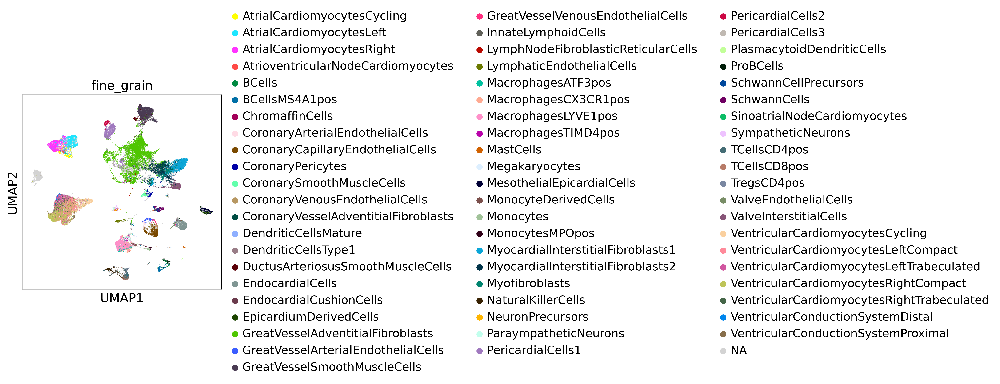

In [35]:
sc.pl.umap(adata, color=["fine_grain"],ncols=1)

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


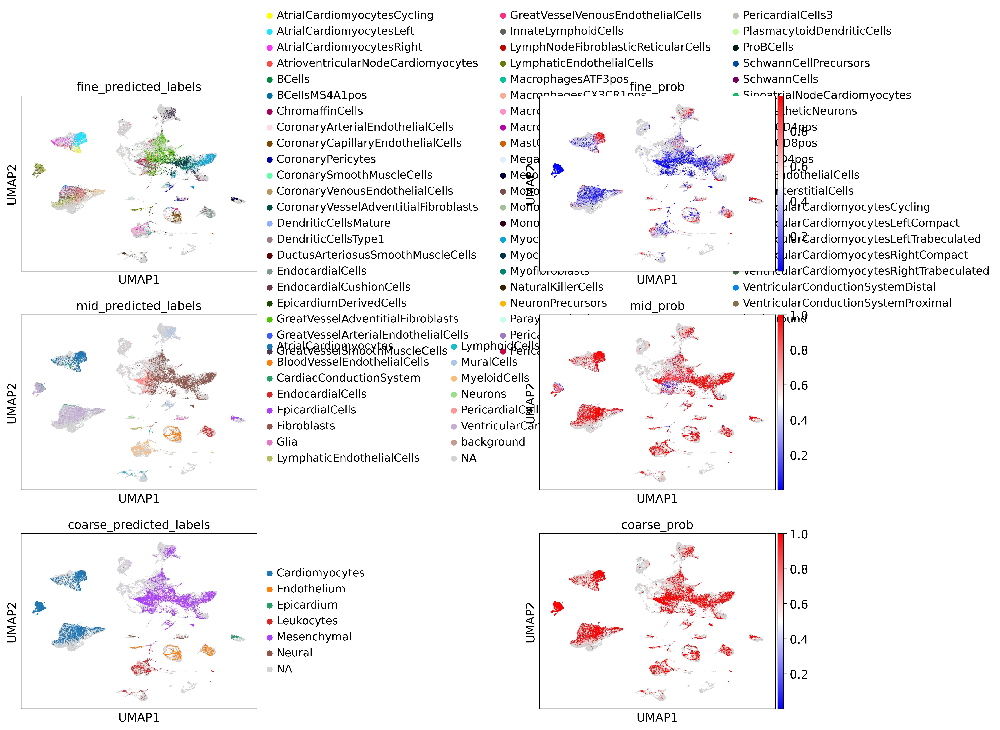

In [36]:
cols = ['fine_predicted_labels','fine_prob',
        'mid_predicted_labels','mid_prob',
       'coarse_predicted_labels','coarse_prob']
sc.pl.umap(adata, color=cols, ncols=2, wspace=1,cmap='bwr')

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch1

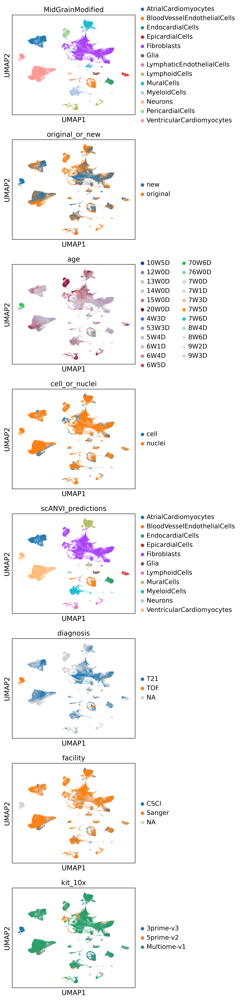

In [37]:
sc.pl.umap(adata, color=[cell_type_key,"original_or_new","age","cell_or_nuclei","scANVI_predictions","diagnosis","facility","kit_10x"],ncols=1)

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


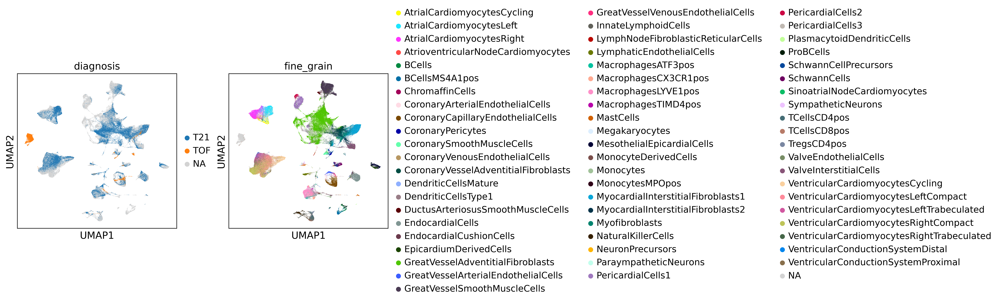

In [38]:
sc.pl.umap(adata, color=["diagnosis","fine_grain"],ncols=2)

In [39]:
adata.obs['fine_grain'] = adata.obs['fine_grain'].astype('str')
adata.obs['fine_predicted_labels'] = adata.obs['fine_predicted_labels'].astype('str')
adata.obs['fine_grain_integrated'] = adata.obs['fine_grain'].replace('nan', np.nan).fillna(adata.obs['fine_predicted_labels'].replace('nan', np.nan))
adata.obs['fine_grain_integrated'] = adata.obs['fine_grain_integrated'].astype('category')

In [40]:
adata.obs['mid_grain'] = adata.obs['mid_grain'].astype('str')
adata.obs['mid_predicted_labels'] = adata.obs['mid_predicted_labels'].astype('str')
adata.obs['mid_grain_integrated'] = adata.obs['mid_grain'].replace('nan', np.nan).fillna(adata.obs['mid_predicted_labels'].replace('nan', np.nan))
adata.obs['mid_grain_integrated'] = adata.obs['mid_grain_integrated'].astype('category')

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


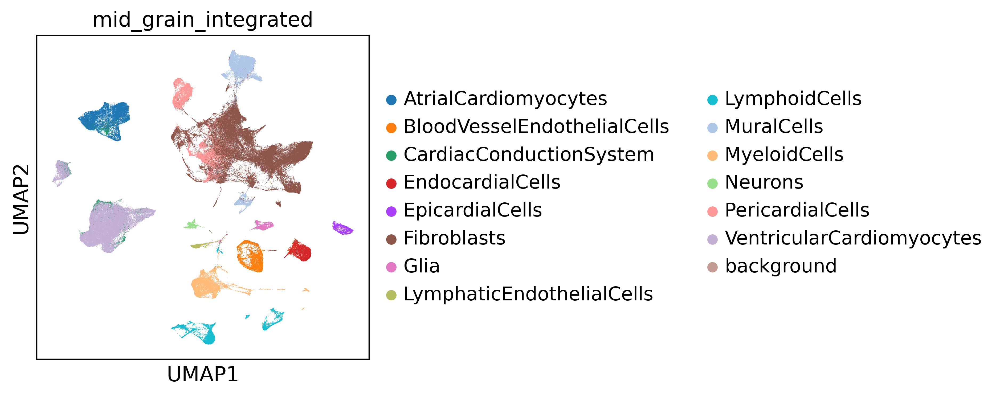

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


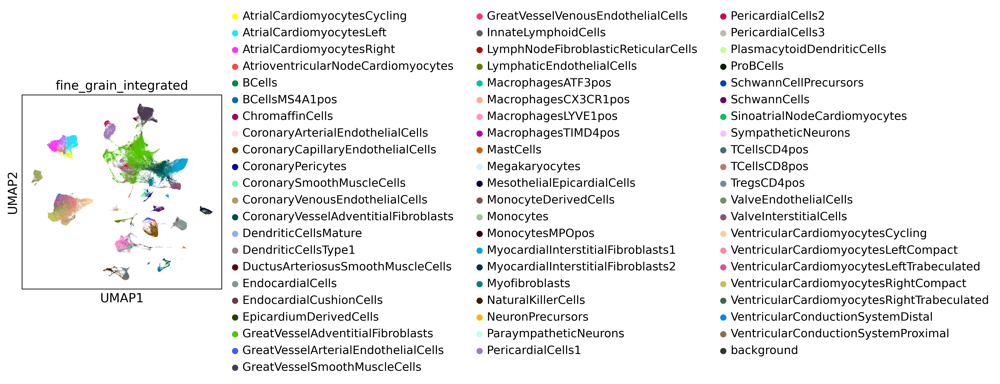

In [41]:
sc.pl.umap(adata, color=["mid_grain_integrated"],ncols=1)
sc.pl.umap(adata, color=["fine_grain_integrated"],ncols=1)

In [42]:
# Add the new category 'Atlas' to the 'diagnosis' column
adata.obs['diagnosis'] = adata.obs['diagnosis'].cat.add_categories('Atlas')

# Replace NaN values with 'Atlas'
adata.obs['diagnosis'] = adata.obs['diagnosis'].fillna('Atlas')

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


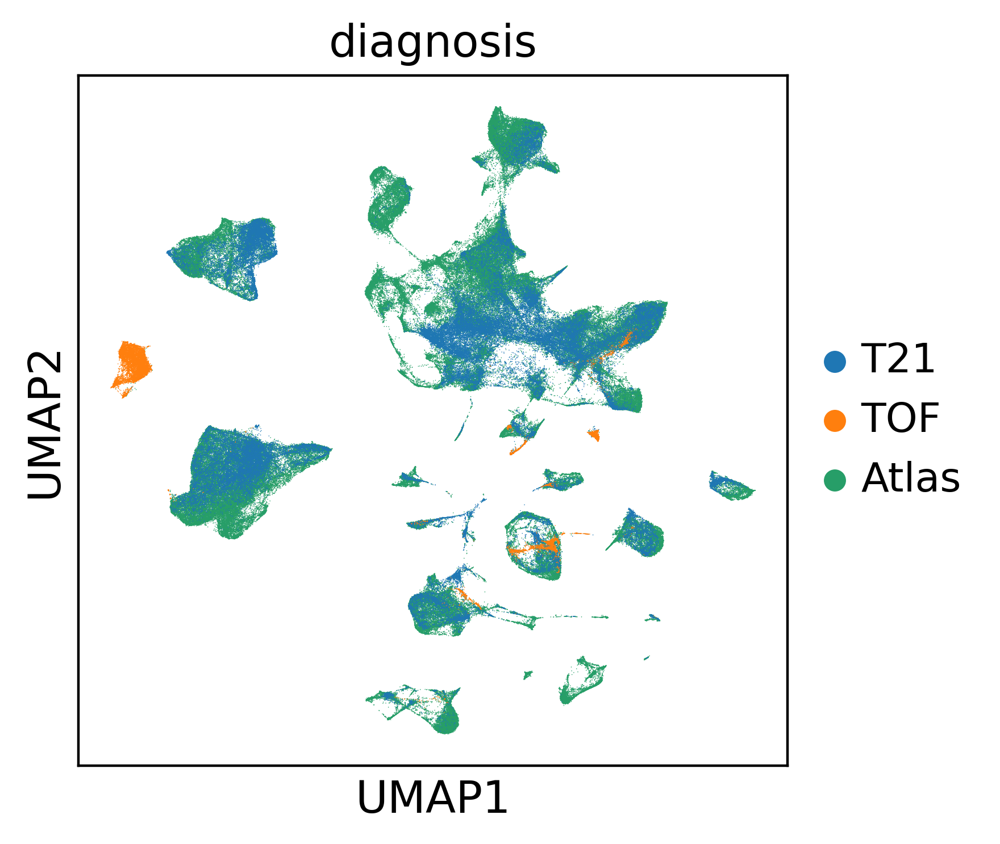

In [43]:
sc.pl.umap(adata, color=["diagnosis"],ncols=1)

In [ ]:
# Save the UMAP plot
plot_name="AtlasT21ToFIntegrated.svg"
sc.pl.umap(adata, color=["diagnosis","mid_grain_integrated"], save=plot_name, ncols=2)
cwd=os.getcwd()
path=os.path.join(cwd,"figures","umap"+plot_name)
print(path)
! /software/rclone/rclone copy {path} gdrive:Sanger-CSCI_data_share/Manuscript/Figures/Figure6 --drive-shared-with-me --progress

/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/lustre/scratch126/cellgen/team205/jc48/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


# Save full object

In [46]:
adata

AnnData object with n_obs × n_vars = 389667 × 18642
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'region', 'age', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', 'FACSgate', 'fine_grain', 'mid_grain', 'coarse_grain', 'sex', 'week', 'trimester', 'heart_or_greatvessels', 'cycling', 'S_score', 'G2M_score', 'phase', '_scvi_labels', 'stress_score', 'hb1_score', 'MidGrainModified', 'diagnosis', 'original_or_new', 'age_original', 'age_days', 'batch', 'cell_type', 'scANVI_predictions', 'coars

In [45]:
# convert adata.obsm keys to strings (were integers)
for key in adata.obsm.keys():
    if isinstance(adata.obsm[key], pd.DataFrame):
        adata.obsm[key].columns = adata.obsm[key].columns.astype(str)

In [47]:
file_path="/nfs/team205/heart/anndata_objects/Foetal/trisomy21/AtlasT21ToFIntegratedRaw.h5ad"
adata.write(file_path)

In [48]:
! /software/rclone/rclone copy {file_path} gdrive:Sanger-CSCI_data_share/27Jun23 --drive-shared-with-me --progress

Transferred:   	          0 B / 6.012 GiB, 0%, 0 B/s, ETA -
Transferred:            0 / 1, 0%
Elapsed time:         1.5s
Transferring:
 *                 AtlasT21ToFIntegratedRaw.h5ad:  0% /6.012Gi, 0/s, -Transferred:   	    3.027 MiB / 6.012 GiB, 0%, 0 B/s, ETA -
Transferred:            0 / 1, 0%
Elapsed time:         2.0s
Transferring:
 *                 AtlasT21ToFIntegratedRaw.h5ad:  0% /6.012Gi, 0/s, -Transferred:   	    4.402 MiB / 6.012 GiB, 0%, 3.524 MiB/s, ETA 29m5s
Transferred:            0 / 1, 0%
Elapsed time:         2.5s
Transferring:
 *                 AtlasT21ToFIntegratedRaw.h5ad:  0% /6.012Gi, 3.525Mi/s, 29m5sTransferred:   	    7.121 MiB / 6.012 GiB, 0%, 3.524 MiB/s, ETA 29m4s
Transferred:            0 / 1, 0%
Elapsed time:         3.0s
Transferring:
 *                 AtlasT21ToFIntegratedRaw.h5ad:  0% /6.012Gi, 3.525Mi/s, 29m4sTransferred:   	        8 MiB / 6.012 GiB, 0%, 3.998 MiB/s, ETA 25m37s
Transferred:            0 / 1, 0%
Elapsed time:         3.5s
Transfer